<a href="https://colab.research.google.com/github/SisekoC/My-Notebooks/blob/main/Clustering_with_dim_reduction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Clustering and dimeonsionality reduction techniques combined
### Dr. Tirthajyoti Sarkar, Fremont, CA 94536

In this notebook, we show how the clustering performance changes when dimensionality reduction techniques like Principal component analysis (PCA), Independent component analysis (ICA), or Random projections (RP) is combined with algorithms like k-means.

[Read about ___k-means clustering algorithm___ here.](https://en.wikipedia.org/wiki/K-means_clustering)

[Read about ___principal component analysis___ here](https://en.wikipedia.org/wiki/Principal_component_analysis)

[Read about ___independent component analysis___ here](https://en.wikipedia.org/wiki/Independent_component_analysis)

---

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

### Create synthetic data using Scikit learn `make_blob` method

- Number of features: 8
- Number of clusters: 5
- Number of samples: 1000

In [2]:
from sklearn.datasets import make_classification
from sklearn.datasets import make_blobs

In [3]:
n_features = 8
n_cluster = 5
cluster_std = 1.5
n_samples = 1000

In [4]:
data1 = make_blobs(n_samples=n_samples,n_features=n_features,centers=n_cluster,cluster_std=cluster_std)

In [5]:
d1 = data1[0]

In [6]:
df1=pd.DataFrame(data=d1,columns=['Feature_'+str(i) for i in range(1,n_features+1)])
df1.head()

,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8
0,5.769750,3.504946,1.315642,5.905865,3.278482,-8.622271,-5.712725,10.249354
1,-4.700335,-9.483712,5.763555,-5.029192,-11.524014,5.789851,-0.391763,-9.358921
2,7.151750,1.447367,-0.347684,8.564976,1.470636,-9.196264,-6.126249,7.593783
3,0.380395,5.593066,-4.704509,3.420985,5.695538,4.415059,-2.168617,-4.813469
4,4.193956,-4.910969,2.321248,-4.856264,8.961432,9.862875,-6.670684,6.458209


In [7]:
from itertools import combinations

In [8]:
lst_vars=list(combinations(df1.columns,2))

In [9]:
len(lst_vars)

28

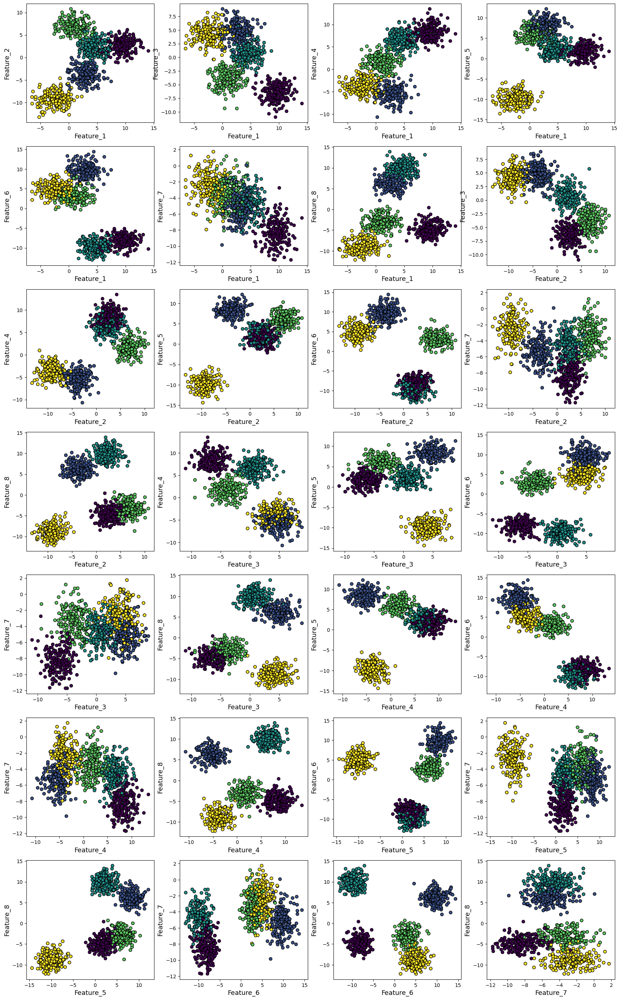

In [10]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=data1[1],edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

In [11]:
df1.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Feature_1,1000.0,3.093608,4.230939,-6.506908,0.018835,2.852576,5.694137,14.062485
Feature_2,1000.0,-0.232626,5.806678,-13.270533,-4.760091,1.465264,4.013724,10.794229
Feature_3,1000.0,-0.110244,4.652442,-10.961891,-4.481726,0.625104,4.026043,8.873517
Feature_4,1000.0,1.475592,5.642742,-10.690211,-4.037197,1.757517,6.801383,13.476150
Feature_5,1000.0,1.703758,6.447421,-14.381450,0.247496,2.951189,6.462206,12.183787
Feature_6,1000.0,-0.051812,7.729101,-13.056457,-8.296947,2.668668,6.050193,14.382799
Feature_7,1000.0,-4.846326,2.509962,-11.722066,-6.389817,-4.649953,-3.069589,1.745892
Feature_8,1000.0,-0.142801,7.180440,-12.186829,-5.853583,-2.726259,7.012160,13.888803


### How are the classes separated (boxplots)

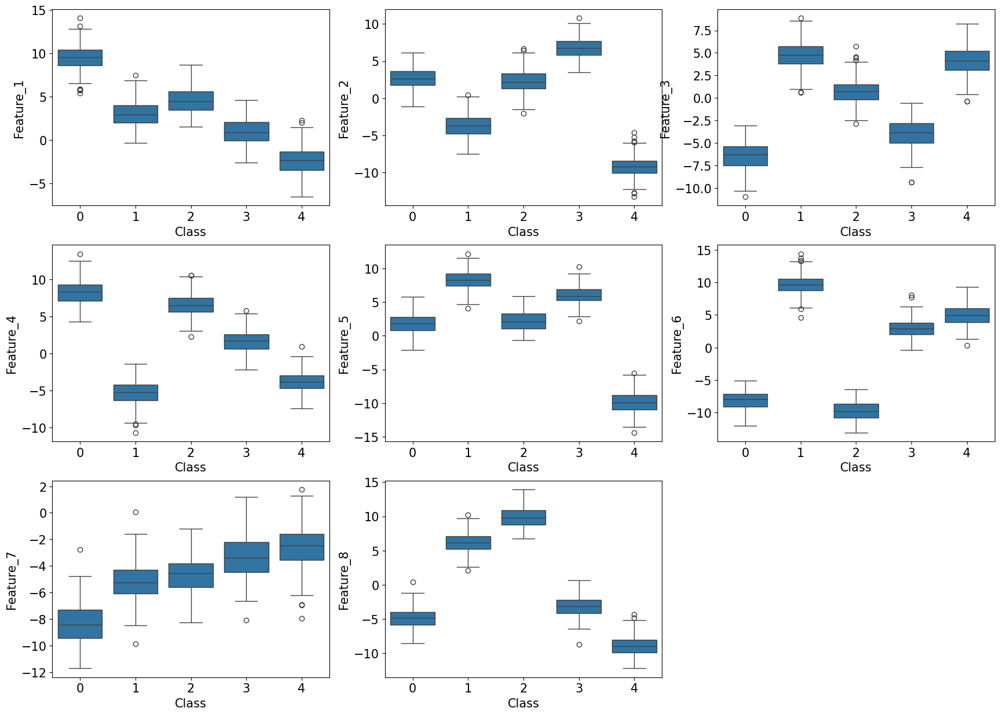

In [12]:
plt.figure(figsize=(21,15))
for i,c in enumerate(df1.columns):
    plt.subplot(3,3,i+1)
    sns.boxplot(y=df1[c],x=data1[1])
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.xlabel("Class",fontsize=15)
    plt.ylabel(c,fontsize=15)
    #plt.show()

## k-means clustering

In [13]:
from sklearn.cluster import KMeans

### Unlabled data

In [14]:
X=df1

In [15]:
X.head()

,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8
0,5.769750,3.504946,1.315642,5.905865,3.278482,-8.622271,-5.712725,10.249354
1,-4.700335,-9.483712,5.763555,-5.029192,-11.524014,5.789851,-0.391763,-9.358921
2,7.151750,1.447367,-0.347684,8.564976,1.470636,-9.196264,-6.126249,7.593783
3,0.380395,5.593066,-4.704509,3.420985,5.695538,4.415059,-2.168617,-4.813469
4,4.193956,-4.910969,2.321248,-4.856264,8.961432,9.862875,-6.670684,6.458209


In [16]:
y=data1[1]

### Scaling

In [17]:
from sklearn.preprocessing import MinMaxScaler

In [18]:
scaler = MinMaxScaler()

In [19]:
X_scaled=scaler.fit_transform(X)

### Metrics

In [20]:
from sklearn.metrics import silhouette_score, adjusted_rand_score, completeness_score, v_measure_score

### Running k-means and computing inter-cluster distance score for various *k* values

In [21]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_scaled)
    preds = km.predict(X_scaled)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_scaled)))
    km_scores.append(-km.score(X_scaled))
    silhouette = silhouette_score(X_scaled,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

Score for number of cluster(s) 2: -265.29249530811205
Silhouette score for number of cluster(s) 2: 0.42224741492076656
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -165.79201605855107
Silhouette score for number of cluster(s) 3: 0.5082028119593907
V-measure score for number of cluster(s) 3: 0.7424834172925042
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -100.23103857900308
Silhouette score for number of cluster(s) 4: 0.5553374161237589
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -41.0933692407016
Silhouette score for number of cluster(s) 5: 0.6759247091307539
V-measure score for number of cluster(

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

Score for number of cluster(s) 6: -39.1987528436014
Silhouette score for number of cluster(s) 6: 0.5799394505857911
V-measure score for number of cluster(s) 6: 0.958713438090832
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 7: -37.65135458712866
Silhouette score for number of cluster(s) 7: 0.46426835578413467
V-measure score for number of cluster(s) 7: 0.921078078496612
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 8: -35.76241306722793
Silhouette score for number of cluster(s) 8: 0.3723545888583887
V-measure score for number of cluster(s) 8: 0.8864473241055977
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 9: -34.244607527413095
Silhouette score for number of cluster(s) 9: 0.27045990964408395
V-measure score for number of cluster(s)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


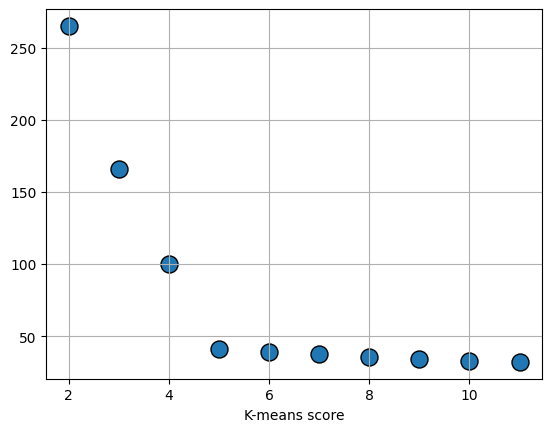

In [22]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("K-means score")
plt.show()

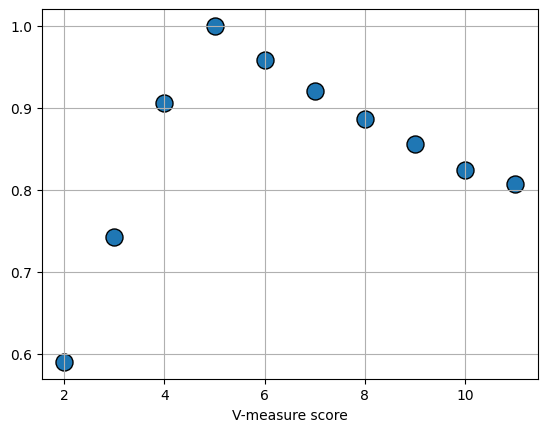

In [23]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("V-measure score")
plt.show()

In [24]:
km = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_scaled)

In [25]:
preds_km = km.predict(X_scaled)

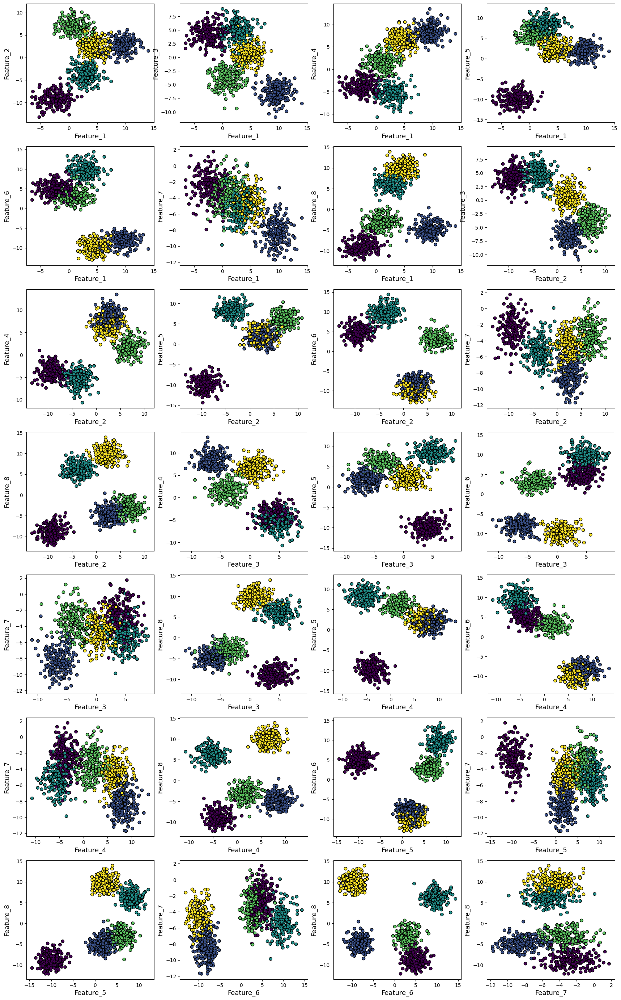

In [26]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=preds_km,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## Expectation-maximization (Gaussian Mixture Model)

In [27]:
from sklearn.mixture import GaussianMixture

In [28]:
gm_bic= []
gm_score=[]
for i in range(2,12):
    gm = GaussianMixture(n_components=i,n_init=10,tol=1e-3,max_iter=1000).fit(X_scaled)
    print("BIC for number of cluster(s) {}: {}".format(i,gm.bic(X_scaled)))
    print("Log-likelihood score for number of cluster(s) {}: {}".format(i,gm.score(X_scaled)))
    print("-"*100)
    gm_bic.append(-gm.bic(X_scaled))
    gm_score.append(gm.score(X_scaled))

BIC for number of cluster(s) 2: -12895.971606746947
Log-likelihood score for number of cluster(s) 2: 6.755380913288179
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 3: -14655.687217342762
Log-likelihood score for number of cluster(s) 3: 7.790663212363184
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 4: -15296.3654027651
Log-likelihood score for number of cluster(s) 4: 8.266426798851452
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 5: -15921.093278046836
Log-likelihood score for number of cluster(s) 5: 8.734215230269417
----------------------------------------------------------------------------------------------------
BIC for number of cluster(s) 6: -15711.30483722318
Log-likelihood score for number of cluster(s) 6: 8.784745503634687
----

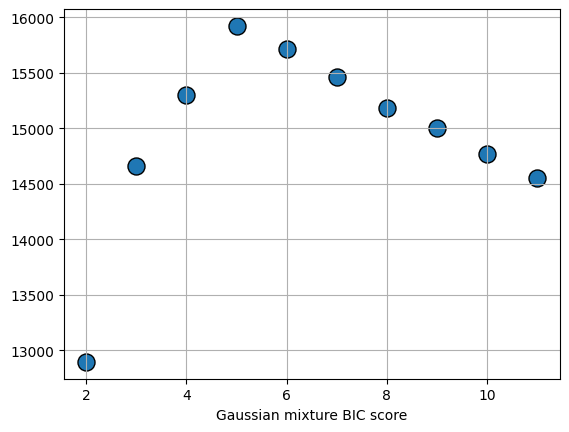

In [29]:
plt.scatter(x=[i for i in range(2,12)],y=gm_bic,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Gaussian mixture BIC score")
plt.show()

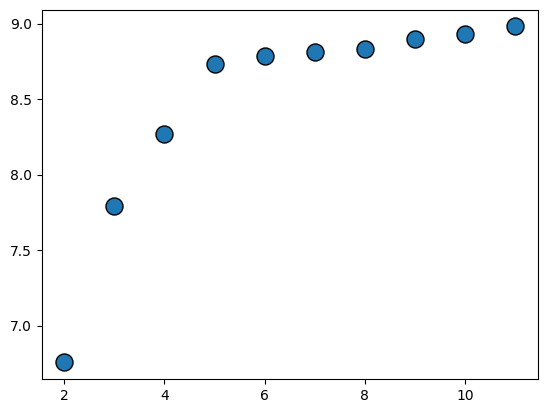

In [30]:
plt.scatter(x=[i for i in range(2,12)],y=gm_score,s=150,edgecolor='k')
plt.show()

In [31]:
gm = GaussianMixture(n_components=5,verbose=1,n_init=10,tol=1e-2,covariance_type='full',max_iter=1000).fit(X_scaled)

Initialization 0
Initialization converged: True
Initialization 1
Initialization converged: True
Initialization 2
Initialization converged: True
Initialization 3
Initialization converged: True
Initialization 4
Initialization converged: True
Initialization 5
Initialization converged: True
Initialization 6
Initialization converged: True
Initialization 7
Initialization converged: True
Initialization 8
Initialization converged: True
Initialization 9
Initialization converged: True


In [32]:
gm.means_

array([[0.77918532, 0.66078196, 0.22968643, 0.7866375 , 0.6071388 ,
        0.1796256 , 0.25010407, 0.28406764],
       [0.36233536, 0.83634914, 0.35786304, 0.51081285, 0.76971089,
        0.583978  , 0.61836983, 0.34798492],
       [0.20040268, 0.16896486, 0.76217528, 0.28587867, 0.17023962,
        0.65567747, 0.67891927, 0.12702253],
       [0.4567746 , 0.39626866, 0.7935648 , 0.2201262 , 0.85470187,
        0.82883598, 0.47938241, 0.70496295],
       [0.53499176, 0.64655615, 0.59213362, 0.71363938, 0.62570066,
        0.12159829, 0.52585345, 0.84540328]])

In [33]:
km.cluster_centers_

array([[0.20040268, 0.16896486, 0.76217528, 0.28587867, 0.17023962,
        0.65567747, 0.67891927, 0.12702253],
       [0.77918532, 0.66078196, 0.22968643, 0.7866375 , 0.6071388 ,
        0.1796256 , 0.25010407, 0.28406764],
       [0.4567746 , 0.39626866, 0.7935648 , 0.2201262 , 0.85470187,
        0.82883598, 0.47938241, 0.70496295],
       [0.36233536, 0.83634914, 0.35786304, 0.51081285, 0.76971089,
        0.583978  , 0.61836983, 0.34798492],
       [0.53499176, 0.64655615, 0.59213362, 0.71363938, 0.62570066,
        0.12159829, 0.52585345, 0.84540328]])

In [34]:
gm.means_/km.cluster_centers_

array([[3.88809824, 3.91076563, 0.30135644, 2.75164809, 3.56637778,
        0.2739542 , 0.36838558, 2.23635646],
       [0.4650182 , 1.26569608, 1.55805043, 0.64936244, 1.26776757,
        3.25108448, 2.47245012, 1.22500722],
       [0.4387343 , 0.42638966, 0.96044492, 1.29870353, 0.19918012,
        0.7910823 , 1.41623736, 0.18018326],
       [1.26064042, 0.4738077 , 2.21750982, 0.43093317, 1.11041936,
        1.41929316, 0.77523576, 2.02584341],
       [1.        , 1.        , 1.        , 1.        , 1.        ,
        1.        , 1.        , 1.        ]])

In [35]:
preds_gm=gm.predict(X_scaled)

In [36]:
km_rand_score = adjusted_rand_score(preds_km,y)

In [37]:
gm_rand_score = adjusted_rand_score(preds_gm,y)

In [38]:
print("Adjusted Rand score for k-means",km_rand_score)
print("Adjusted Rand score for Gaussian Mixture model",gm_rand_score)

Adjusted Rand score for k-means 1.0
Adjusted Rand score for Gaussian Mixture model 1.0


In [39]:
silhouette_score(X_scaled,preds_km)

0.6759247091307539

In [40]:
silhouette_score(X_scaled,preds_gm)

0.6759247091307539

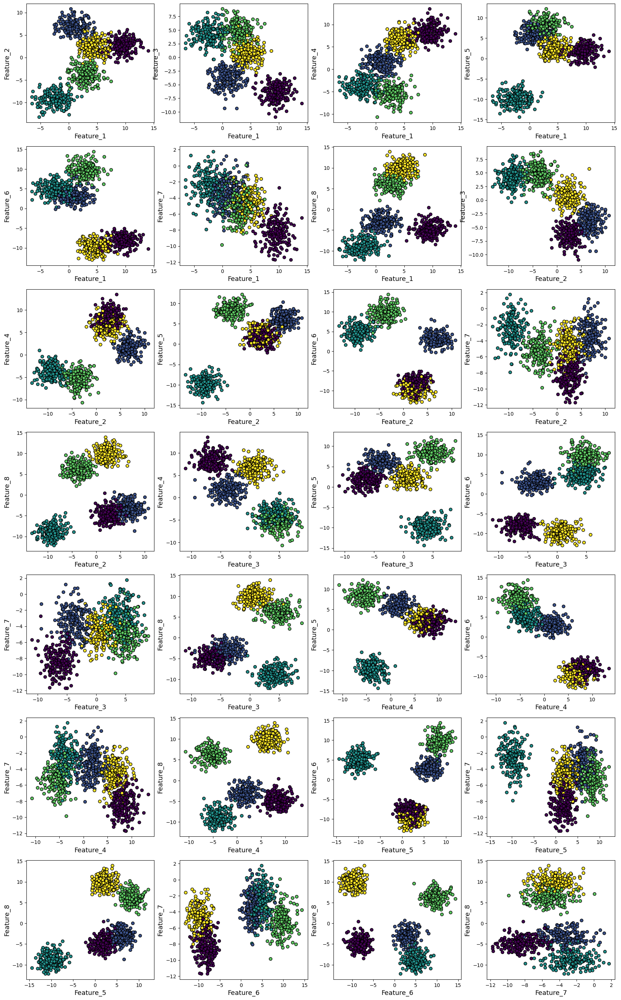

In [41]:
plt.figure(figsize=(21,35))
for i in range(1,29):
    plt.subplot(7,4,i)
    dim1=lst_vars[i-1][0]
    dim2=lst_vars[i-1][1]
    plt.scatter(df1[dim1],df1[dim2],c=preds_gm,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## PCA

In [42]:
from sklearn.decomposition import PCA

In [43]:
n_prin_comp = 3

In [44]:
pca_partial = PCA(n_components=n_prin_comp,svd_solver='full')
pca_partial.fit(X_scaled)

PCA(n_components=3, svd_solver='full')

In [45]:
pca_full = PCA(n_components=n_features,svd_solver='full')
pca_full.fit(X_scaled)

PCA(n_components=8, svd_solver='full')

### How much variance is explained by principal components?

With the help of this plot, we can decide to work with only the first 3 principal components

In [46]:
pca_explained_var = pca_full.explained_variance_ratio_

In [47]:
cum_explaiend_var = pca_explained_var.cumsum()

In [48]:
cum_explaiend_var

array([0.49362012, 0.73496049, 0.87138785, 0.95467034, 0.97464398,
       0.98533746, 0.99329243, 1.        ])

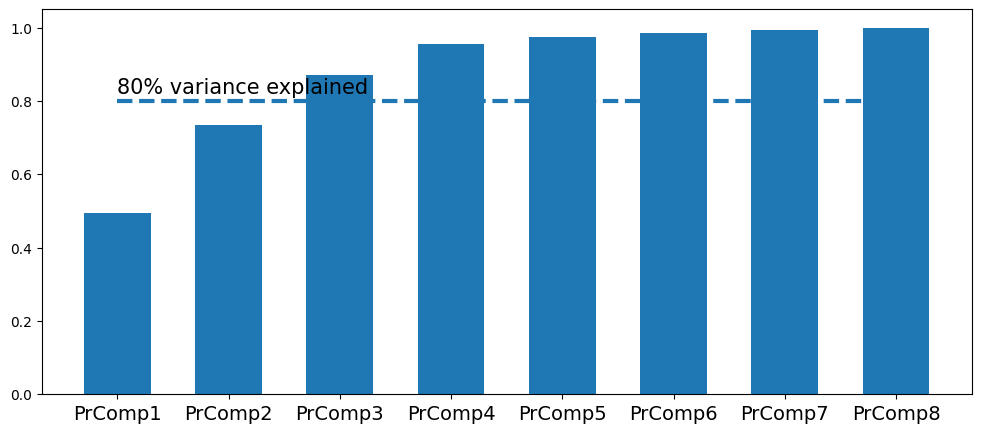

In [49]:
plt.figure(figsize=(12,5))
plt.bar(x=['PrComp'+str(i) for i in range(1,9)],height=cum_explaiend_var,width=0.6)
plt.xticks(fontsize=14)
plt.hlines(y=0.8,xmin='PrComp1',xmax='PrComp8',linestyles='dashed',lw=3)
plt.text(x='PrComp1',y=0.82,s="80% variance explained",fontsize=15)
plt.show()

### Transform the original variables in principal component space and create a DataFrame

In [50]:
X_pca = pca_partial.fit_transform(X_scaled)

In [51]:
df_pca=pd.DataFrame(data=X_pca,columns=['Principal_comp'+str(i) for i in range(1,n_prin_comp+1)])

### Running k-means on the transformed features

In [52]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_pca)
    preds = km.predict(X_pca)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_pca)))
    km_scores.append(-km.score(X_pca))
    silhouette = silhouette_score(X_pca,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

Score for number of cluster(s) 2: -210.49156313379964
Silhouette score for number of cluster(s) 2: 0.48454190279366194
V-measure score for number of cluster(s) 2: 0.589727521756156
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -110.8068839552528
Silhouette score for number of cluster(s) 3: 0.5793229096400648
V-measure score for number of cluster(s) 3: 0.7918756684685214
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -56.772209543751636
Silhouette score for number of cluster(s) 4: 0.6653322451328024
V-measure score for number of cluster(s) 4: 0.9057460992755191
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -11.962907325796605
Silhouette score for number of cluster(s) 5: 0.8031011847141365
V-measure score for number of cluster

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Silhouette score for number of cluster(s) 9: 0.3620306464723856
V-measure score for number of cluster(s) 9: 0.8532489806105061
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 10: -8.83808177577148
Silhouette score for number of cluster(s) 10: 0.24319293235587525
V-measure score for number of cluster(s) 10: 0.8231574654332662
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for number of cluster(s) 11: -8.386246438652366
Silhouette score for number of cluster(s) 11: 0.24473787122677645
V-measure score for number of cluster(s) 11: 0.8067455710122571
----------------------------------------------------------------------------------------------------


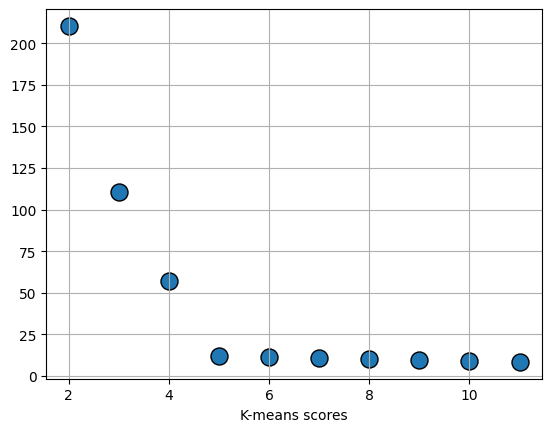

In [53]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("K-means scores")
plt.show()

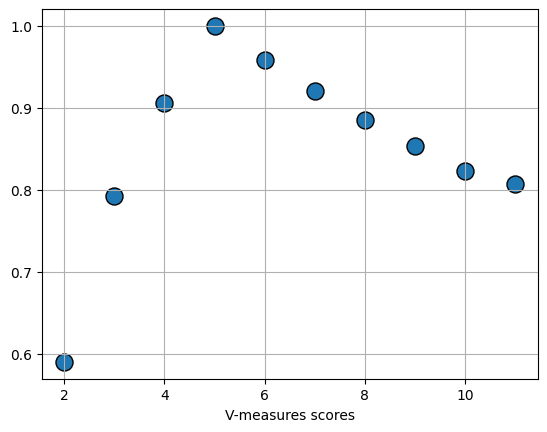

In [54]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("V-measures scores")
plt.show()

### K-means fitting with PCA-transformed data

In [55]:
km_pca = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_pca)
preds_km_pca = km_pca.predict(X_pca)

### Visualizing the clusters after running k-means on PCA-transformed features

In [56]:
col_pca_combi=list(combinations(df_pca.columns,2))
num_pca_combi = len(col_pca_combi)

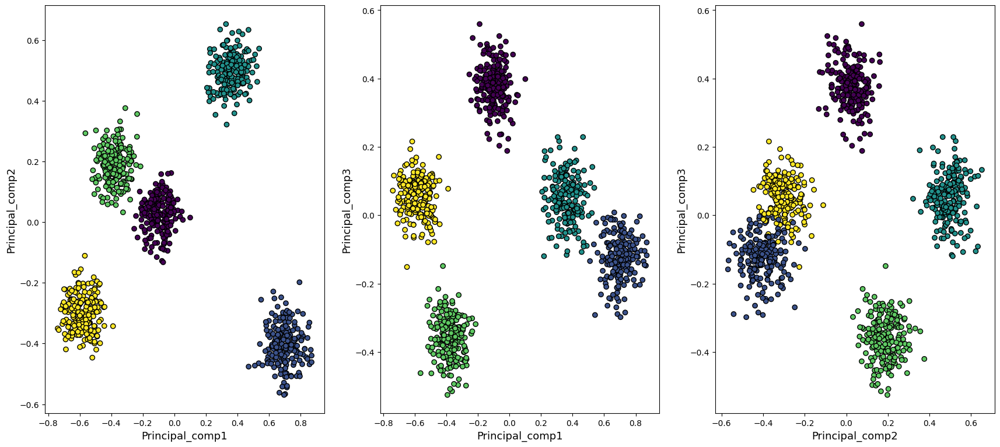

In [57]:
plt.figure(figsize=(21,20))
for i in range(1,num_pca_combi+1):
    plt.subplot(int(num_pca_combi/3)+1,3,i)
    dim1=col_pca_combi[i-1][0]
    dim2=col_pca_combi[i-1][1]
    plt.scatter(df_pca[dim1],df_pca[dim2],c=preds_km_pca,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## ICA

In [58]:
from sklearn.decomposition import FastICA

In [59]:
n_ind_comp = 3

In [60]:
ica_partial = FastICA(n_components=n_ind_comp)
ica_partial.fit(X_scaled)

FastICA(n_components=3)

In [61]:
ica_full = FastICA(max_iter=1000)
ica_full.fit(X_scaled)

FastICA(max_iter=1000)

In [62]:
X_ica = ica_partial.fit_transform(X_scaled)

In [63]:
df_ica=pd.DataFrame(data=X_ica,columns=['Independent_comp'+str(i) for i in range(1,n_ind_comp+1)])

### Running k-means on the independent features

In [64]:
km_scores= []
km_silhouette = []
vmeasure_score =[]
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_ica)
    preds = km.predict(X_ica)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_ica)))
    km_scores.append(-km.score(X_ica))
    silhouette = silhouette_score(X_ica,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

Score for number of cluster(s) 2: -2032.0664674227507
Silhouette score for number of cluster(s) 2: 0.423430225164647
V-measure score for number of cluster(s) 2: 0.4743509876140318
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -1082.3854955877287
Silhouette score for number of cluster(s) 3: 0.5667259199500754
V-measure score for number of cluster(s) 3: 0.7918756684685214
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -485.8297055038118
Silhouette score for number of cluster(s) 4: 0.6773519055739314
V-measure score for number of cluster(s) 4: 0.9017229806745893
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -115.25291376638468
Silhouette score for number of cluster(s) 5: 0.7972805726336988
V-measure score for number of cluster(

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` ex

Silhouette score for number of cluster(s) 9: 0.4100230395020201
V-measure score for number of cluster(s) 9: 0.8538491382074834
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 10: -74.98668782761183
Silhouette score for number of cluster(s) 10: 0.29661767460741395
V-measure score for number of cluster(s) 10: 0.8246242105711449
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 11: -71.58380096224818
Silhouette score for number of cluster(s) 11: 0.2815217470347824
V-measure score for number of cluster(s) 11: 0.8069792123653449
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


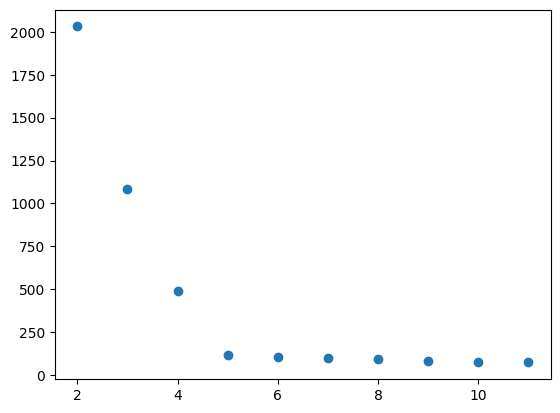

In [65]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores)
plt.show()

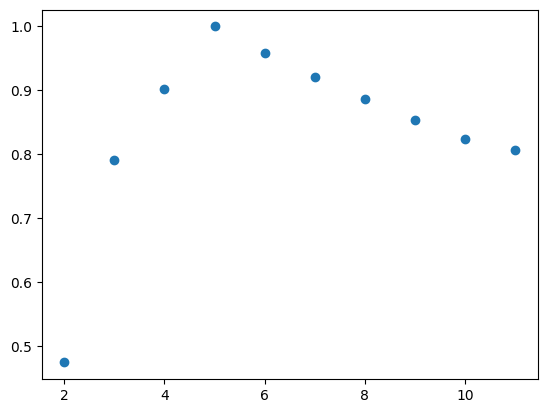

In [66]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score)
plt.show()

### K-means fitting with ICA-transformed data

In [67]:
km_ica = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_ica)
preds_km_ica = km_ica.predict(X_ica)

### Visualizing the clusters after running k-means on ICA-transformed features

In [68]:
col_ica_combi=list(combinations(df_ica.columns,2))
num_ica_combi = len(col_ica_combi)

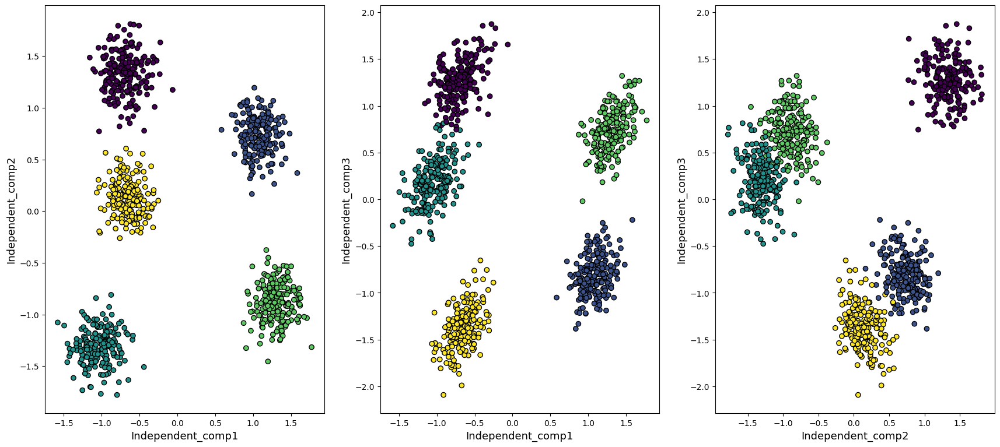

In [69]:
plt.figure(figsize=(21,20))
for i in range(1,num_ica_combi+1):
    plt.subplot(int(num_ica_combi/3)+1,3,i)
    dim1=col_ica_combi[i-1][0]
    dim2=col_ica_combi[i-1][1]
    plt.scatter(df_ica[dim1],df_ica[dim2],c=preds_km_ica,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)

## Random Projection

In [70]:
from sklearn.random_projection import GaussianRandomProjection

In [71]:
n_random_comp = 3

In [72]:
random_proj = GaussianRandomProjection(n_components=n_random_comp)

In [73]:
X_random_proj = random_proj.fit_transform(X_scaled)

In [74]:
df_random_proj=pd.DataFrame(data=X_random_proj,columns=['Random_projection'+str(i) for i in range(1,n_random_comp+1)])

### Running k-means on random projections

In [75]:
km_scores= []
km_silhouette = []
vmeasure_score = []
for i in range(2,12):
    km = KMeans(n_clusters=i, random_state=0).fit(X_random_proj)
    preds = km.predict(X_random_proj)
    print("Score for number of cluster(s) {}: {}".format(i,km.score(X_random_proj)))
    km_scores.append(-km.score(X_random_proj))
    silhouette = silhouette_score(X_random_proj,preds)
    km_silhouette.append(silhouette)
    print("Silhouette score for number of cluster(s) {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    vmeasure_score.append(v_measure)
    print("V-measure score for number of cluster(s) {}: {}".format(i,v_measure))
    print("-"*100)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for number of cluster(s) 2: -210.07195583442603
Silhouette score for number of cluster(s) 2: 0.4401832111956385
V-measure score for number of cluster(s) 2: 0.41405464409020565
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 3: -117.96051501518245
Silhouette score for number of cluster(s) 3: 0.4705323474101261
V-measure score for number of cluster(s) 3: 0.6481390258967239
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 4: -75.39658971172987
Silhouette score for number of cluster(s) 4: 0.5001136504074746
V-measure score for number of cluster(s) 4: 0.8301311953761625
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 5: -40.538814786705586
Silhouette score for number of cluster(s) 5: 0.5828067720211855
V-measure score for number of cluste

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for number of cluster(s) 7: -33.43021487592269
Silhouette score for number of cluster(s) 7: 0.4784494177303761
V-measure score for number of cluster(s) 7: 0.8877135377363287
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 8: -29.76378898219911
Silhouette score for number of cluster(s) 8: 0.4258895251136982
V-measure score for number of cluster(s) 8: 0.8474646790377821
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for number of cluster(s) 9: -26.685313902587154
Silhouette score for number of cluster(s) 9: 0.36723581258902777
V-measure score for number of cluster(s) 9: 0.8136032026230129
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 10: -24.410153153621348


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Silhouette score for number of cluster(s) 10: 0.33058337919711506
V-measure score for number of cluster(s) 10: 0.8029214874863914
----------------------------------------------------------------------------------------------------
Score for number of cluster(s) 11: -23.000373540469788
Silhouette score for number of cluster(s) 11: 0.3277997417900416
V-measure score for number of cluster(s) 11: 0.7867072780297556
----------------------------------------------------------------------------------------------------


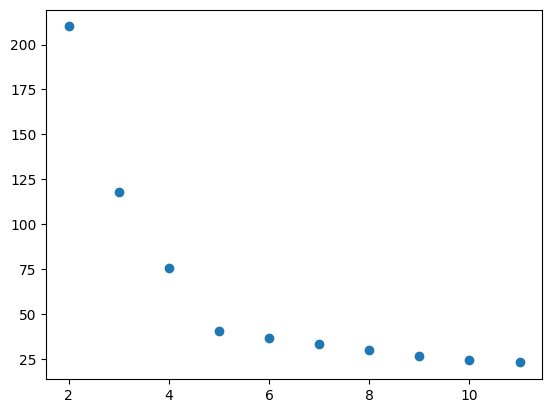

In [76]:
plt.scatter(x=[i for i in range(2,12)],y=km_scores)
plt.show()

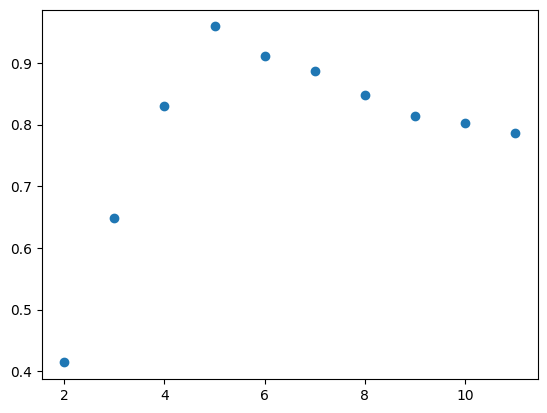

In [77]:
plt.scatter(x=[i for i in range(2,12)],y=vmeasure_score)
plt.show()

### K-means fitting with random-projected data

In [78]:
km_random_proj = KMeans(n_clusters=5,n_init=10,max_iter=500).fit(X=X_random_proj)
preds_km_random_proj = km_random_proj.predict(X_random_proj)

### Visualizing the clusters after running k-means on random-projected features

In [79]:
col_random_proj_combi=list(combinations(df_random_proj.columns,2))
num_random_proj_combi = len(col_random_proj_combi)

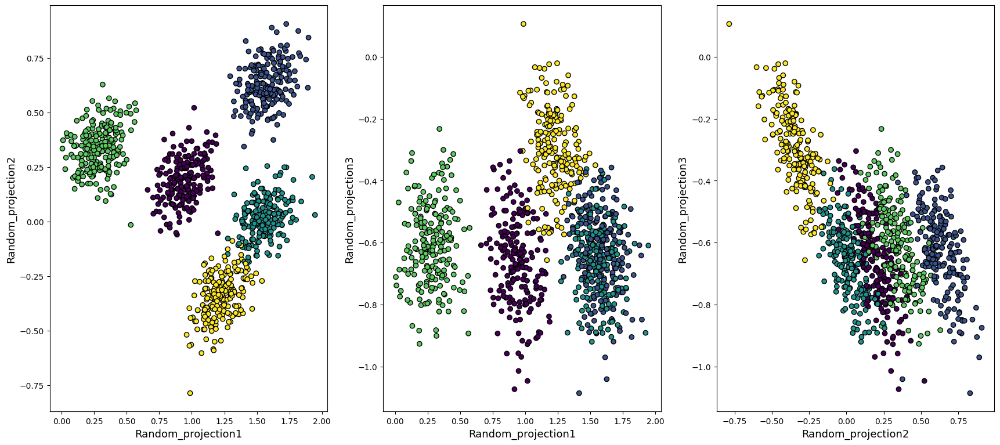

In [80]:
plt.figure(figsize=(21,20))
for i in range(1,num_random_proj_combi+1):
    plt.subplot(int(num_random_proj_combi/3)+1,3,i)
    dim1=col_random_proj_combi[i-1][0]
    dim2=col_random_proj_combi[i-1][1]
    plt.scatter(df_random_proj[dim1],df_random_proj[dim2],c=preds_km_random_proj,edgecolor='k')
    plt.xlabel(f"{dim1}",fontsize=13)
    plt.ylabel(f"{dim2}",fontsize=13)
plt.show()

In [81]:
def plot_cluster_rp(df_rp,preds_rp):
    """
    Plots clusters after running random projection
    """
    plt.figure(figsize=(21,12))
    for i in range(1,num_random_proj_combi+1):
        plt.subplot(int(num_random_proj_combi/3)+1,3,i)
        dim1=col_random_proj_combi[i-1][0]
        dim2=col_random_proj_combi[i-1][1]
        plt.scatter(df_rp[dim1],df_rp[dim2],c=preds_rp,edgecolor='k')
        plt.xlabel(f"{dim1}",fontsize=13)
        plt.ylabel(f"{dim2}",fontsize=13)
    plt.show()

### Running the random projections many times

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 0: -47.18573279494416
Silhouette score for iteration 0: 0.5261394979915567
V-measure score for iteration 0: 0.9563137827440596
----------------------------------------------------------------------------------------------------


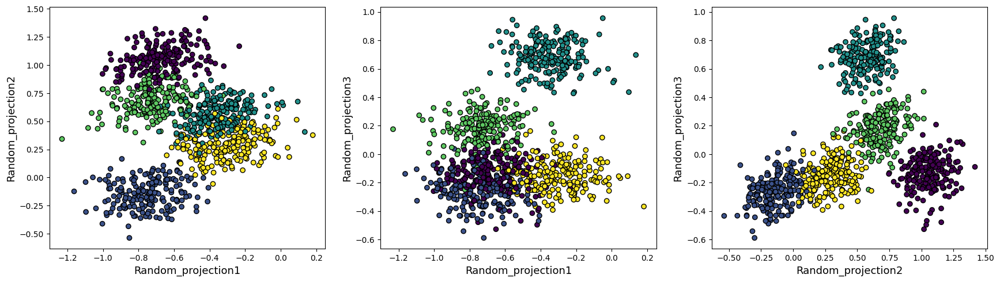

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 1: -27.863160111846952
Silhouette score for iteration 1: 0.35291793741250727
V-measure score for iteration 1: 0.46501094412631655
----------------------------------------------------------------------------------------------------


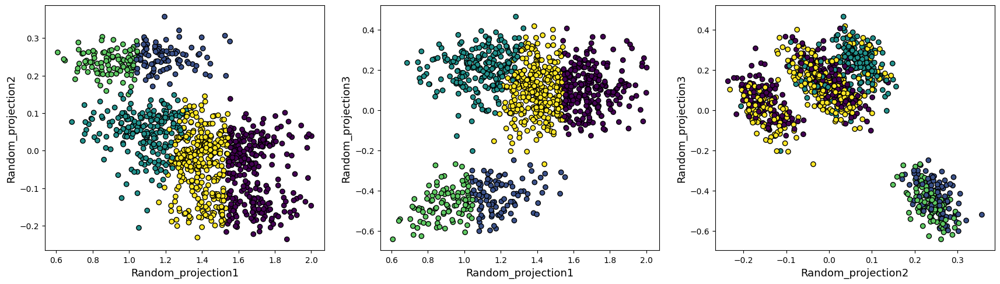

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 2: -32.53481837896576
Silhouette score for iteration 2: 0.6105566366808011
V-measure score for iteration 2: 0.9487655839151239
----------------------------------------------------------------------------------------------------


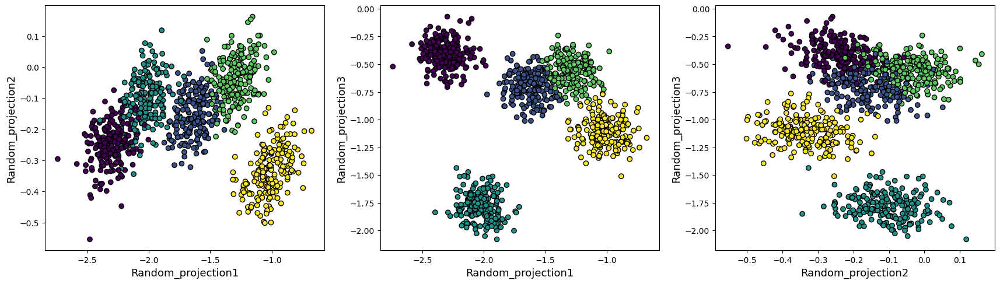

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 3: -66.055413421143
Silhouette score for iteration 3: 0.5544076023601177
V-measure score for iteration 3: 0.9824871174724426
----------------------------------------------------------------------------------------------------


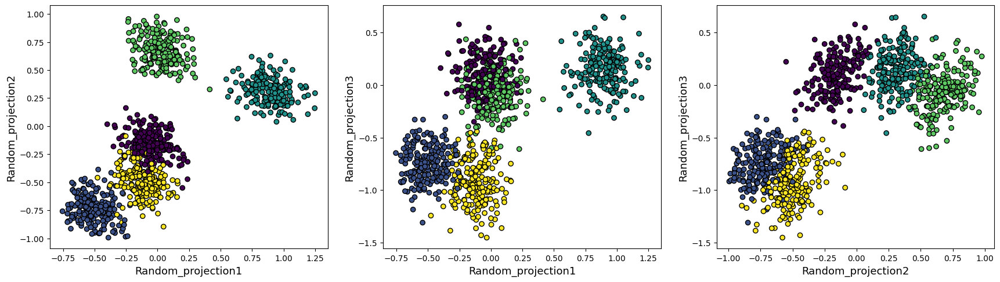

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 4: -76.24332931166771
Silhouette score for iteration 4: 0.6373949473255128
V-measure score for iteration 4: 0.9781371627112428
----------------------------------------------------------------------------------------------------


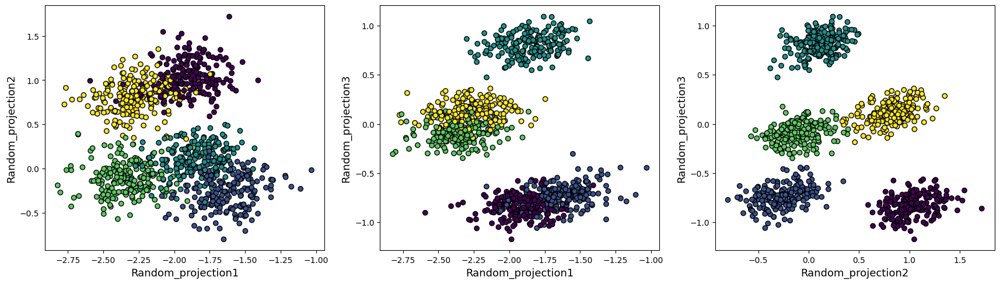

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 5: -41.586924317973605
Silhouette score for iteration 5: 0.5470761461212074
V-measure score for iteration 5: 0.8652795327377462
----------------------------------------------------------------------------------------------------


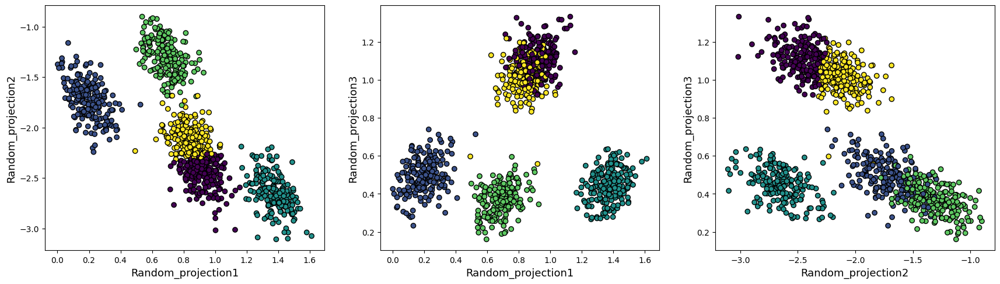

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 6: -50.00870445736268
Silhouette score for iteration 6: 0.524476835389434
V-measure score for iteration 6: 0.8500136793881627
----------------------------------------------------------------------------------------------------


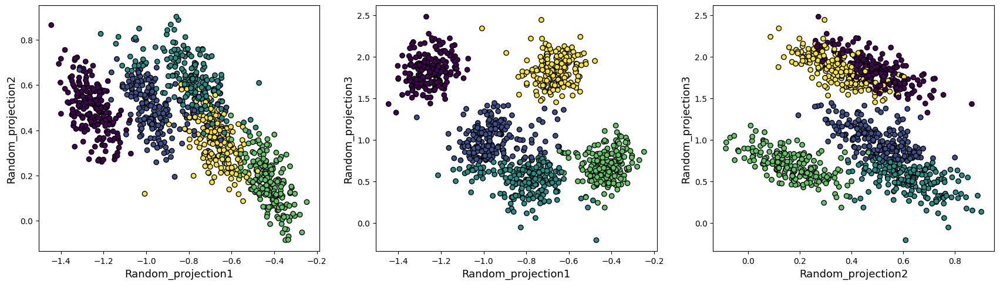

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 7: -39.10447589003525
Silhouette score for iteration 7: 0.43728454577394393
V-measure score for iteration 7: 0.8394826566767505
----------------------------------------------------------------------------------------------------


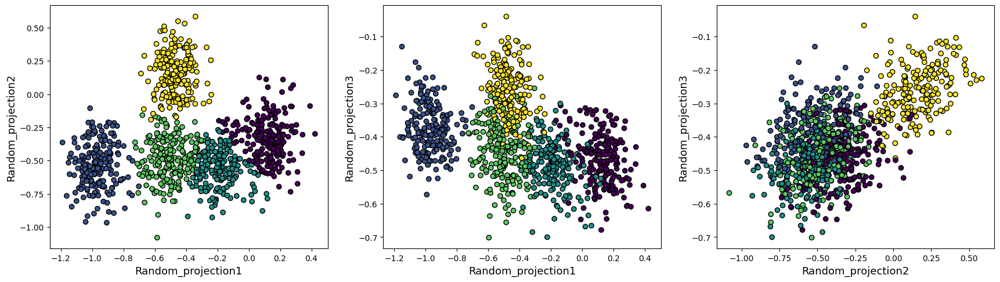

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 8: -49.81332986360843
Silhouette score for iteration 8: 0.43726906965879125
V-measure score for iteration 8: 0.7422749456924801
----------------------------------------------------------------------------------------------------


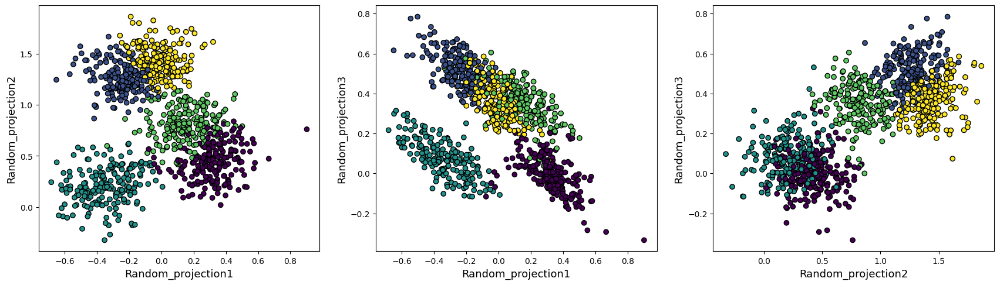

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 9: -19.16288860779125
Silhouette score for iteration 9: 0.5637975681394062
V-measure score for iteration 9: 0.958790775554156
----------------------------------------------------------------------------------------------------


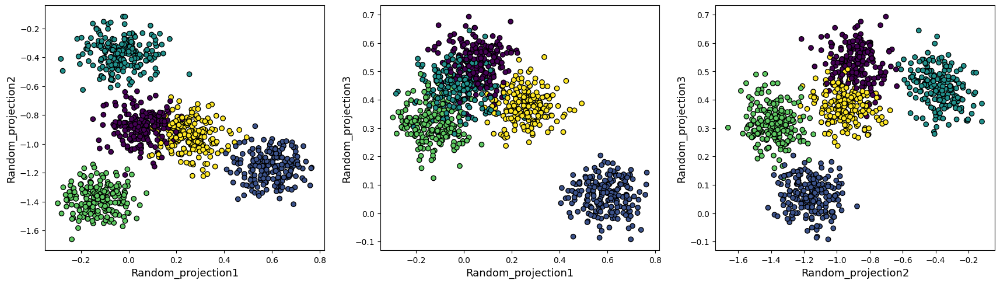

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 10: -70.87818650795299
Silhouette score for iteration 10: 0.593537261025561
V-measure score for iteration 10: 0.9843511876439808
----------------------------------------------------------------------------------------------------


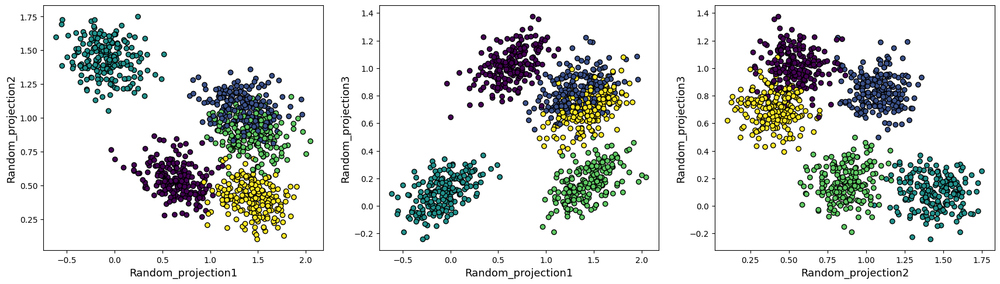

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 11: -27.24207374914663
Silhouette score for iteration 11: 0.4155609377721178
V-measure score for iteration 11: 0.718603390524948
----------------------------------------------------------------------------------------------------


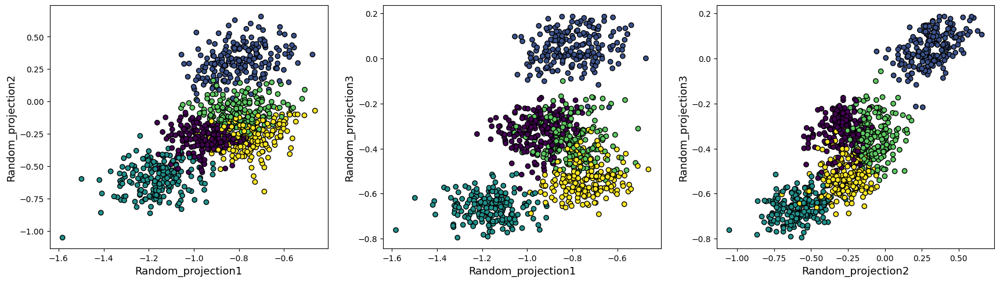

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 12: -37.43119647404723
Silhouette score for iteration 12: 0.6398310319653385
V-measure score for iteration 12: 0.9921763826478879
----------------------------------------------------------------------------------------------------


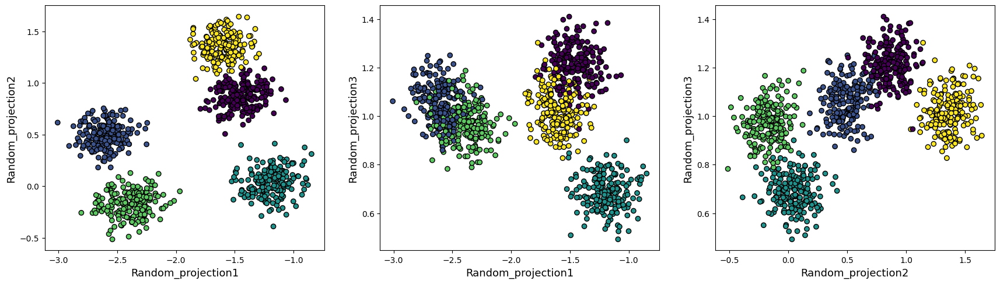

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 13: -31.845771511122695
Silhouette score for iteration 13: 0.48747937901840954
V-measure score for iteration 13: 0.7714954369016104
----------------------------------------------------------------------------------------------------


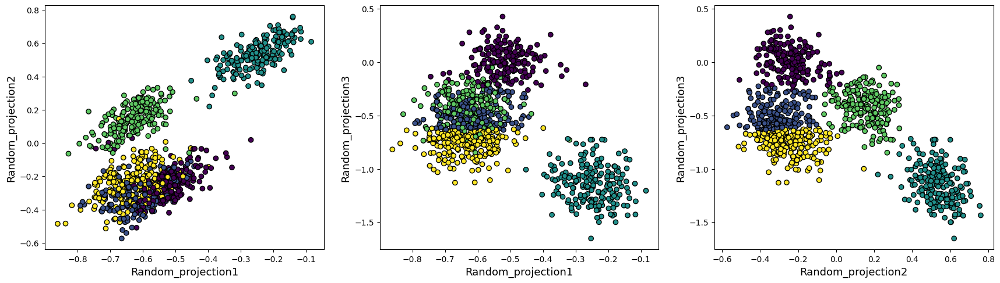

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 14: -29.992941789072766
Silhouette score for iteration 14: 0.33212058644780573
V-measure score for iteration 14: 0.5405014287730441
----------------------------------------------------------------------------------------------------


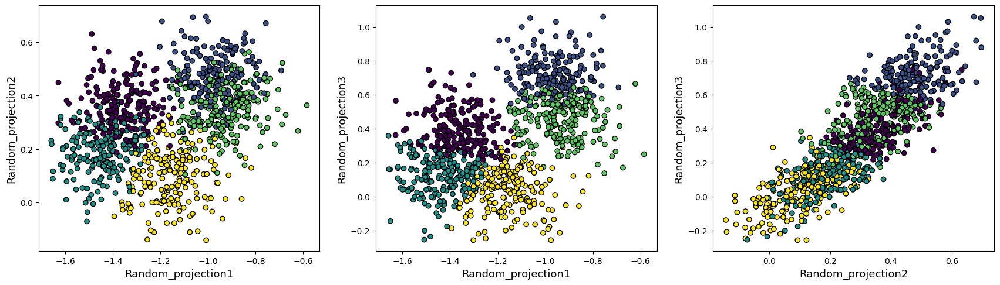

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 15: -21.893921499751542
Silhouette score for iteration 15: 0.4300017059049701
V-measure score for iteration 15: 0.7100132997652278
----------------------------------------------------------------------------------------------------


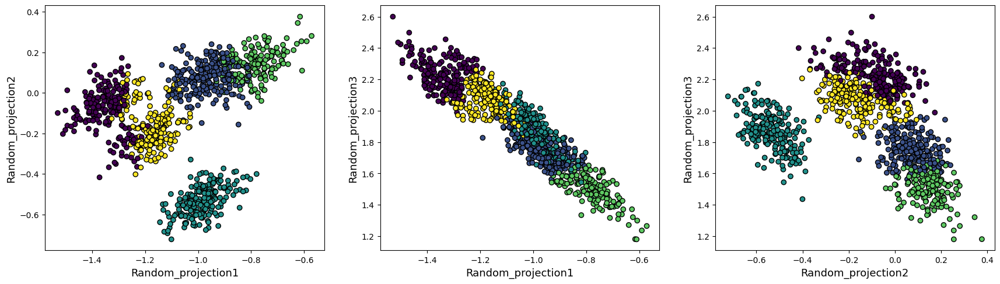

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 16: -21.254251720989775
Silhouette score for iteration 16: 0.6242035101818518
V-measure score for iteration 16: 0.9808515004252839
----------------------------------------------------------------------------------------------------


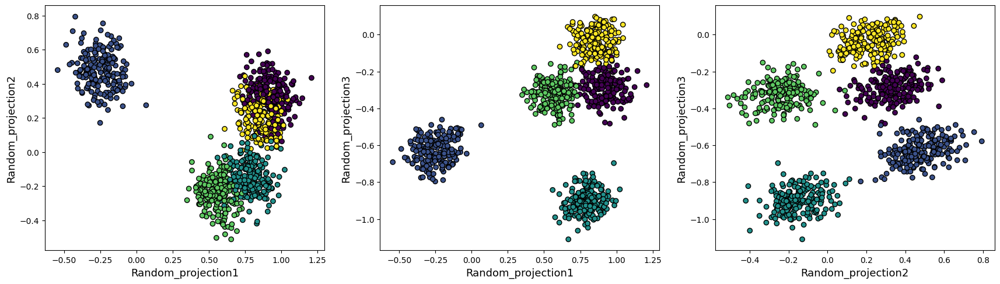

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 17: -30.856834242786306
Silhouette score for iteration 17: 0.44859080940090484
V-measure score for iteration 17: 0.8800269036383237
----------------------------------------------------------------------------------------------------


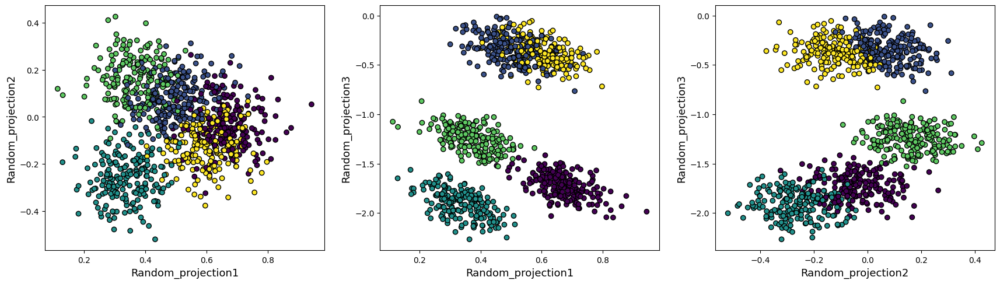

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 18: -42.97002265110143
Silhouette score for iteration 18: 0.45428563762997437
V-measure score for iteration 18: 0.7540194969926622
----------------------------------------------------------------------------------------------------


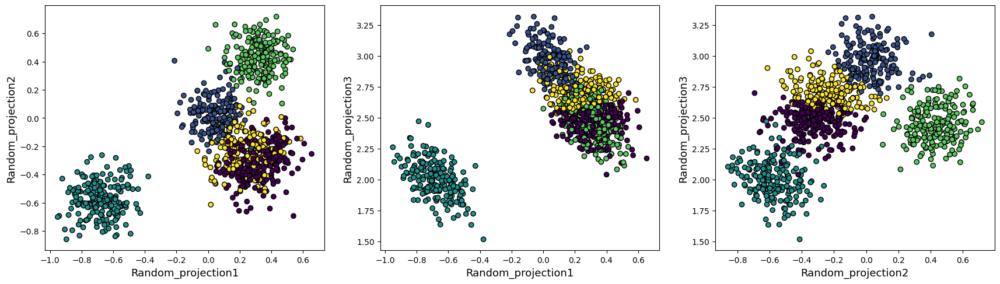

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 19: -20.758191174841702
Silhouette score for iteration 19: 0.5791209916947903
V-measure score for iteration 19: 0.9166623923376627
----------------------------------------------------------------------------------------------------


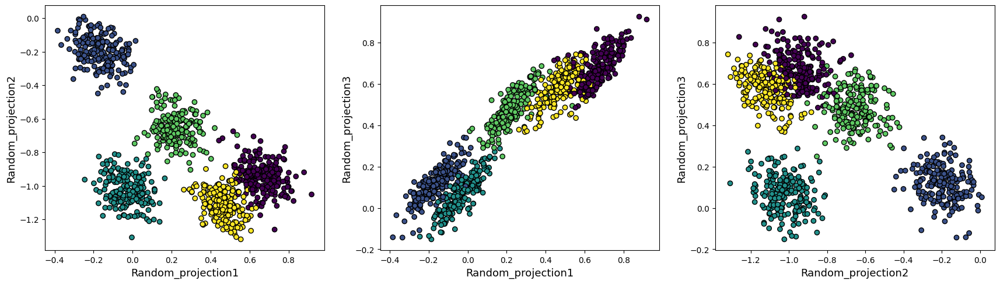

In [82]:
rp_score= []
rp_silhouette = []
rp_vmeasure = []
for i in range(20):
    random_proj = GaussianRandomProjection(n_components=n_random_comp)
    X_random_proj = random_proj.fit_transform(X_scaled)
    df_random_proj=pd.DataFrame(data=X_random_proj,columns=['Random_projection'+str(i) for i in range(1,n_random_comp+1)])

    km = KMeans(n_clusters=5, random_state=0).fit(X_random_proj)
    preds = km.predict(X_random_proj)
    print("Score for iteration {}: {}".format(i,km.score(X_random_proj)))
    rp_score.append(-km.score(X_random_proj))

    silhouette = silhouette_score(X_random_proj,preds)
    rp_silhouette.append(silhouette)
    print("Silhouette score for iteration {}: {}".format(i,silhouette))

    v_measure = v_measure_score(y,preds)
    rp_vmeasure.append(v_measure)
    print("V-measure score for iteration {}: {}".format(i,v_measure))
    print("-"*100)

    plot_cluster_rp(df_random_proj,preds)

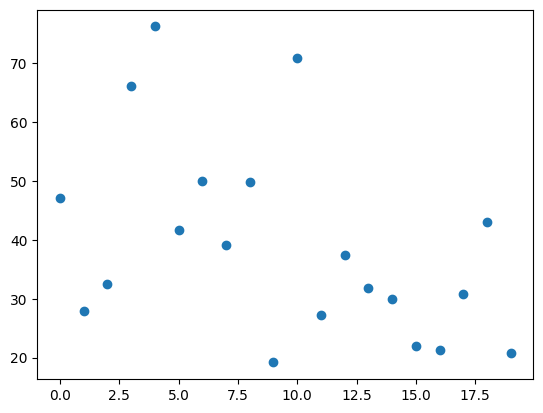

In [83]:
plt.scatter(x=[i for i in range(20)],y=rp_score)
plt.show()

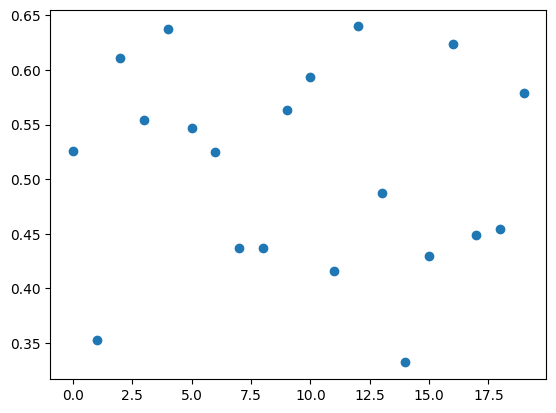

In [84]:
plt.scatter(x=[i for i in range(20)],y=rp_silhouette)
plt.show()

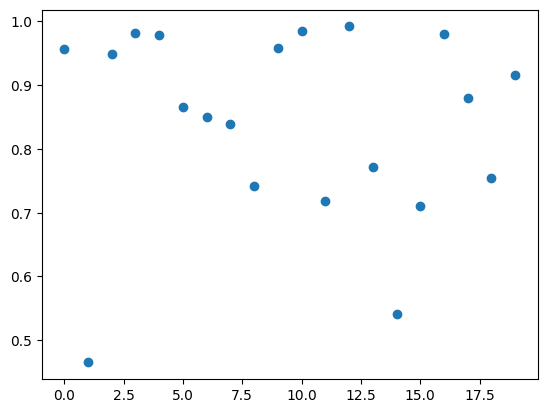

In [85]:
plt.scatter(x=[i for i in range(20)],y=rp_vmeasure)
plt.show()

### This kind of variation does not happen with PCA

In [86]:
pca_score= []
pca_silhouette = []
pca_vmeasure = []
for i in range(20):
    pca_partial = PCA(n_components=n_prin_comp,svd_solver='full')
    X_pca=pca_partial.fit_transform(X_scaled)
    km = KMeans(n_clusters=5, random_state=0).fit(X_pca)
    preds = km.predict(X_pca)
    print("Score for iteration {}: {}".format(i,km.score(X_pca)))
    rp_score.append(-km.score(X_pca))
    silhouette = silhouette_score(X_pca,preds)
    rp_silhouette.append(silhouette)
    print("Silhouette score for iteration {}: {}".format(i,silhouette))
    v_measure = v_measure_score(y,preds)
    rp_vmeasure.append(v_measure)
    print("V-measure score for iteration {}: {}".format(i,v_measure))
    print("-"*100)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 0: -11.962907325796605
Silhouette score for iteration 0: 0.8031011847141365
V-measure score for iteration 0: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 1: -11.962907325796605
Silhouette score for iteration 1: 0.8031011847141365
V-measure score for iteration 1: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 2: -11.962907325796605
Silhouette score for iteration 2: 0.8031011847141365


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


V-measure score for iteration 2: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 3: -11.962907325796605
Silhouette score for iteration 3: 0.8031011847141365
V-measure score for iteration 3: 1.0
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 4: -11.962907325796605
Silhouette score for iteration 4: 0.8031011847141365
V-measure score for iteration 4: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 5: -11.962907325796605


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Silhouette score for iteration 5: 0.8031011847141365
V-measure score for iteration 5: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 6: -11.962907325796605
Silhouette score for iteration 6: 0.8031011847141365
V-measure score for iteration 6: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 7: -11.962907325796605
Silhouette score for iteration 7: 0.8031011847141365
V-measure score for iteration 7: 1.0
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 8: -11.962907325796605
Silhouette score for iteration 8: 0.8031011847141365
V-measure score for iteration 8: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 9: -11.962907325796605


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Silhouette score for iteration 9: 0.8031011847141365
V-measure score for iteration 9: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 10: -11.962907325796605
Silhouette score for iteration 10: 0.8031011847141365
V-measure score for iteration 10: 1.0
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 11: -11.962907325796605
Silhouette score for iteration 11: 0.8031011847141365
V-measure score for iteration 11: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 12: -11.962907325796605


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Silhouette score for iteration 12: 0.8031011847141365
V-measure score for iteration 12: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 13: -11.962907325796605
Silhouette score for iteration 13: 0.8031011847141365
V-measure score for iteration 13: 1.0
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 14: -11.962907325796605
Silhouette score for iteration 14: 0.8031011847141365
V-measure score for iteration 14: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 15: -11.962907325796605


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Silhouette score for iteration 15: 0.8031011847141365
V-measure score for iteration 15: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 16: -11.962907325796605
Silhouette score for iteration 16: 0.8031011847141365
V-measure score for iteration 16: 1.0
----------------------------------------------------------------------------------------------------


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Score for iteration 17: -11.962907325796605
Silhouette score for iteration 17: 0.8031011847141365
V-measure score for iteration 17: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 18: -11.962907325796605


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Silhouette score for iteration 18: 0.8031011847141365
V-measure score for iteration 18: 1.0
----------------------------------------------------------------------------------------------------
Score for iteration 19: -11.962907325796605
Silhouette score for iteration 19: 0.8031011847141365
V-measure score for iteration 19: 1.0
----------------------------------------------------------------------------------------------------
